In [1]:
import numpy as np
import scipy
import matplotlib.pyplot as plt
import sys
sys.path.insert(0, '../src/')

import matplotlib.cm as cm
from profiles import NFW,Green
import os
import anaclass

In [2]:
# datadir = "../../data/40_cross_host_8/"
# files = []    
# for filename in os.listdir(datadir):
#     if filename.startswith('tree') and filename.endswith('evo.npz'): 
#         files.append(filename)

In [3]:
# example = anaclass.Realizations("../../data/150_cross_host_8/", 1e8)
# example.grab_mass("acc", Nhalo=35000) # grabbing only the relevant mass values!

# example.grab_mass("acc_surv", Nhalo=35000)

# example.grab_mass("surv", Nhalo=35000)

In [12]:
hmm1 = np.load("../../data/cross_host/1acc_surv_mass.npy")
hmm2 = np.load("../../data/cross_host/2acc_surv_mass.npy")
hmm3 = np.load("../../data/cross_host/3acc_surv_mass.npy")
hmm4 = np.load("../../data/cross_host/acc_surv_mass.npy")

In [13]:
test = np.append(hmm1, hmm2, axis=0)
test1 = np.append(test, hmm3, axis=0)
test2 = np.append(test1, hmm4, axis=0)

In [17]:
np.save("../../data/cross_host/acc_surv_mass.npy", test2)

(array([ 12.,  95., 259., 357., 351., 331., 251., 177.,  96.,  52.]),
 array([11.7892971, 11.9458189, 12.1023407, 12.2588625, 12.4153843,
        12.5719061, 12.7284279, 12.8849497, 13.0414715, 13.1979933,
        13.3545151]),
 <BarContainer object of 10 artists>)

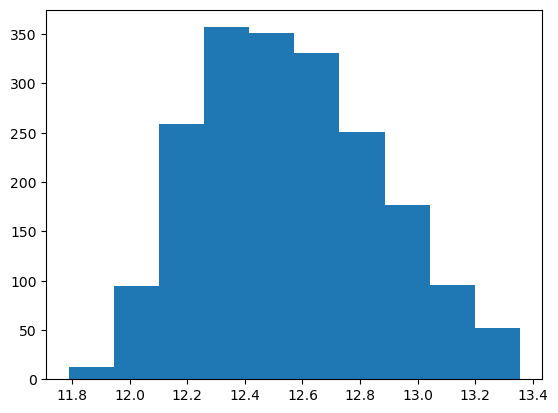

In [16]:
plt.hist(np.log10(test2[:,0]))

In [5]:
ind = []

for i in files:
    ind.append(int(i.split("_")[1]))


In [6]:
full = np.arange(0,150)

In [7]:
evolved = np.sort(ind)

In [8]:
full[~np.in1d(full, evolved)]

array([ 44,  46,  49,  50,  61,  75,  78,  87,  93, 104, 109, 121])

In [9]:
import jsm_serial

In [11]:
jsm_serial.evolve("../../data/150_cross_host_8/broken/", 1e8)

evolving 14 tree realizations
withering
evolving ../../data/150_cross_host_8/broken/tree_104.npz
time elapsed for ../../data/150_cross_host_8/broken/tree_104evo : 1.0780385335286458 minutes
evolving ../../data/150_cross_host_8/broken/tree_104evo.npz
time elapsed for ../../data/150_cross_host_8/broken/tree_104evoevo : 1.104882284005483 minutes
evolving ../../data/150_cross_host_8/broken/tree_109.npz
time elapsed for ../../data/150_cross_host_8/broken/tree_109evo : 0.6018675327301025 minutes
evolving ../../data/150_cross_host_8/broken/tree_109evo.npz
time elapsed for ../../data/150_cross_host_8/broken/tree_109evoevo : 0.5935458660125732 minutes
evolving ../../data/150_cross_host_8/broken/tree_121.npz
../../data/150_cross_host_8/broken/tree_121.npz is corrupted
time elapsed for ../../data/150_cross_host_8/broken/tree_121evo : 0.0246030330657959 minutes
evolving ../../data/150_cross_host_8/broken/tree_44.npz
time elapsed for ../../data/150_cross_host_8/broken/tree_44evo : 0.539505732059478

In [10]:
what = np.load("../../data/150_cross_host_8/broken/tree_46.npz")

In [11]:
def plot_single_realization(tree, nhalo=50, rand=True, i=0):

    mass = tree["mass"]
    time = tree["CosmicTime"]

    if rand==True:
        select = np.random.randint(1,mass.shape[0],nhalo)
    elif rand==False:
        select = np.linspace(i,i+nhalo, nhalo).astype("int")

    colors = cm.viridis(np.linspace(0, 1, nhalo))

    plt.figure(figsize=(6,6))

    for i in range(nhalo):
        plt.plot(time, mass[select[i]], color=colors[i])

    #plt.plot(time, mass[0], color="red")
    plt.xlabel("Gyr", fontsize=15)
    plt.ylabel("halo mass (M$_{\odot}$)", fontsize=15)
    plt.yscale("log")
    plt.axhline(10**8, ls="--", color="black")
    #plt.ylim(1e4,1e14)
    plt.show()

In [14]:
np.log10(np.max(what["mass"]))

13.4749165

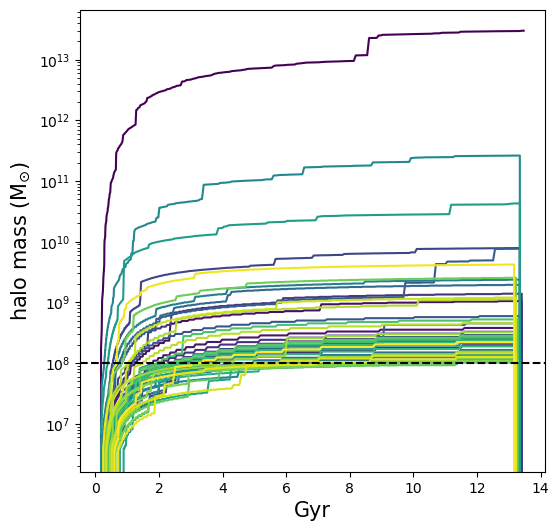

In [12]:
plot_single_realization(what, rand=False)

In [74]:
import config as cfg
import cosmo as co
import evolve as ev
from profiles import NFW,Green
from orbit import orbit
import aux

In [87]:
f = np.load("../../data/150_cross_host_8/broken/tree_121.npz")
redshift = f['redshift']
CosmicTime = f['CosmicTime']
mass = f['mass']
order = f['order']
ParentID = f['ParentID']
VirialRadius = f['VirialRadius']
concentration = f['concentration']
coordinates = f['coordinates']


Rres_factor = 10**(-3)

alpha_type = "conc"

# compute the virial overdensities for all redshifts
VirialOverdensity = co.DeltaBN(redshift, cfg.Om, cfg.OL) # same as Dvsample
GreenRte = np.zeros(VirialRadius.shape) - 99. # contains r_{te} values
alphas = np.zeros(VirialRadius.shape) - 99.
tdyns  = np.zeros(VirialRadius.shape) - 99.

#---identify the roots of the branches
izroot = mass.argmax(axis=1) # root-redshift ids of all the branches
idx = np.arange(mass.shape[0]) # branch ids of all the branches
levels = np.unique(order[order>=0]) # all >0 levels in the tree
izmax = mass.shape[1] - 1 # highest redshift index

#---get smallest host rvir from tree
#   Defunct, we no longer use an Rres; all subhaloes are evolved
#   until their mass falls below resolution limit
min_rvir = VirialRadius[0, np.argwhere(VirialRadius[0,:] > 0)[-1][0]]
cfg.Rres = min(0.1, min_rvir * Rres_factor) # Never larger than 100 pc

#---list of potentials and orbits for each branch
#   additional, mass of ejected subhaloes stored in ejected_mass
#   to be removed from corresponding host at next timestep
potentials = [0] * mass.shape[0]
orbits = [0] * mass.shape[0]
trelease = np.zeros(mass.shape[0])
ejected_mass = np.zeros(mass.shape[0])

#---list of minimum masses, below which we stop evolving the halo
M0 = mass[0,0]
min_mass = np.zeros(mass.shape[0])

#---evolve
for iz in np.arange(izmax, 0, -1): # loop over time to evolve
    iznext = iz - 1                
    z = redshift[iz]
    tcurrent = CosmicTime[iz]
    tnext = CosmicTime[iznext]
    dt = tnext - tcurrent
    Dv = VirialOverdensity[iz]

    for level in levels: #loop from low-order to high-order systems
        for id in idx: # loop over branches
            if order[id,iz]!=level: continue # level by level
            if(iz <= izroot[id]):
                if(iz == izroot[id]): # accretion happens at this timestep
                    # initialize Green profile and orbit

                    za = z
                    ta = tcurrent
                    Dva = Dv
                    ma = mass[id,iz] # initial mass that we will use for f_b
                    c2a = concentration[id,iz]
                    xva = coordinates[id,iz,:]

                    # some edge case produces nan in velocities in TreeGen
                    # if so, print warning and mass fraction lost
                    if(np.any(np.isnan(xva))):
                        print('    WARNING: NaNs detected in init xv of id %d'\
                            % id)
                        print('    Mass fraction of tree lost: %.1e'\
                            % (ma/mass[0,0]))
                        mass[id,:] = -99.
                        coordinates[id,:,:] = 0.
                        idx = np.delete(idx, np.argwhere(idx == id)[0])
                        # this is an extremely uncommon event, but should
                        # eventually be fixed
                        continue

                    print("%%%%%%%%%%%%%%%%%%%%%")
                    print(ma,c2a,Dva,za)

                    potentials[id] = Green(ma,c2a,Delta=Dva,z=za)
                    orbits[id] = orbit(xva)
                    trelease[id] = ta

                    print("%%%%%%%%%%%%%%%%%%%%%")
                    print(potentials)

                    if cfg.evo_mode == 'arbres':
                        min_mass[id] = cfg.phi_res * ma
                    elif cfg.evo_mode == 'withering':
                        min_mass[id] = cfg.Mres #cfg.psi_res * M0

                #---main loop for evolution

                # the p,s,o objects are updated in-place in their arrays
                # unless the orbit is replaced with a new object when released
                ip = ParentID[id,iz]
                p = potentials[ip]
                s = potentials[id]
                
                print("%%%%%%%%%%%%%%%%%%%%%")
                print(ip)
                print(p)


                # update mass of subhalo object based on mass-loss in previous snapshot
                # we wait to do it until now so that the pre-stripped subhalo can be used
                # in the evolution of any higher-order subhaloes
                # We also strip off the mass of any ejected systems
                # the update_mass function handles cases where we fall below resolution limit
                if(s.Mh > min_mass[id]):
                    if(ejected_mass[id] > 0):
                        mass[id,iz] -= ejected_mass[id]
                        ejected_mass[id] = 0
                        mass[id,iz] = max(mass[id,iz], cfg.phi_res*s.Minit)

                    s.update_mass(mass[id,iz])
                    rte = s.rte()

                o = orbits[id]
                xv = orbits[id].xv 
                m = s.Mh
                m_old = m
                r = np.sqrt(xv[0]**2+xv[2]**2)

                #---time since in current host
                t = tnext - trelease[id]

                # Order should always be one higher than parent unless 
                # ejected,in which case it should be the same as parent
                k = order[ip,iznext] + 1

                # alpha: stripping efficiency
                if(alpha_type == 'fixed'):
                    alpha = 0.55
                elif(alpha_type == 'conc'):
                    alpha = ev.alpha_from_c2(p.ch, s.ch)
                    eerd

                #---evolve satellite
                # as long as the mass is larger than resolution limit
                if m > min_mass[id]:

                    # evolve subhalo properties
                    m,lt = ev.msub(s,p,xv,dt,choice='King62',
                        alpha=alpha)

                else: # we do nothing about disrupted satellite, s.t.,
                    # its properties right before disruption would be 
                    # stored in the output arrays
                    pass

                #---evolve orbit
                if m > min_mass[id]:
                    # NOTE: We previously had an additional check on r>Rres
                    # here, where Rres = 10^-3 Rvir(z), but I removed it
                    # All subhalo orbits are evolved until their mass falls
                    # below the resolution limit.
                    # NOTE: No use integrating orbit any longer once the halo
                    # is disrupted, this just slows it down
                
                    tdyn = p.tdyn(r)
                    o.integrate(t,p,m_old)
                    xv = o.xv # note that the coordinates are updated 
                    # internally in the orbit instance "o" when calling
                    # the ".integrate" method, here we assign them to 
                    # a new variable "xv" only for bookkeeping
                    
                else: # i.e., the satellite has merged to its host, so
                    # no need for orbit integration; to avoid potential 
                    # numerical issues, we assign a dummy coordinate that 
                    # is almost zero but not exactly zero
                    tdyn = p.tdyn(cfg.Rres)
                    xv = np.array([cfg.Rres,0.,0.,0.,0.,0.])

                r = np.sqrt(xv[0]**2+xv[2]**2)
                m_old = m


                #---if order>1, determine if releasing this high-order 
                #   subhalo to its grandparent-host, and if releasing,
                #   update the orbit instance
                if k>1:
                
                    if (r > VirialRadius[ip,iz]) & (iz <= izroot[ip]): 
                        # <<< Release condition:
                        # 1. Host halo is already within a grandparent-host
                        # 2. Instant orbital radius is larger than the host
                        # TIDAL radius (note that VirialRadius also contains
                        # the tidal radii for the host haloes once they fall
                        # into a grandparent-host)
                        # 3. (below) We compute the fraction of:
                        #             dynamical time / alpha
                        # corresponding to this dt, and release with
                        # probability dt / (dynamical time / alpha)

                        # Compute probability of being ejected
                        odds = np.random.rand()
                        dyntime_frac = alphas[ip,iz] * dt / tdyns[ip,iz]
                        if(odds < dyntime_frac):
                            if(ParentID[ip,iz] == ParentID[ip,iznext]):
                                # host wasn't also released at same time
                                # New coordinates at next time are the
                                # updated subhalo coordinates plus the updated
                                # host coordinates inside of grandparent
                                xv = aux.add_cyl_vecs(xv,coordinates[ip,iznext,:])
                            else:
                                xv = aux.add_cyl_vecs(xv,coordinates[ip,iz,:])
                                # This will be extraordinarily rare, but just
                                # a check in case so that the released order-k
                                # subhalo isn't accidentally double-released
                                # in terms of updated coordinates, but not
                                # in terms of new host ID.
                            orbits[id] = orbit(xv) # update orbit object
                            k = order[ip,iz] # update instant order to the same as the parent
                            ejected_mass[ip] += m 
                            # add updated subhalo mass to a bucket to be removed from host
                            # at start of next timestep
                            ip = ParentID[ip,iz] # update parent id
                            trelease[id] = tnext # update release time

                #---update the arrays for output
                mass[id,iznext] = m
                order[id,iznext] = k
                ParentID[id,iznext] = ip
                try:
                    VirialRadius[id,iznext] = lt # storing tidal radius
                except UnboundLocalError:
                    # TreeGen gives a few subhaloes with root mass below the
                    # given resolution limit so some subhaloes will never get
                    # an lt assigned if they aren't evolved one step. This can
                    # be fixed by lowering the resolution limit of SubEvo
                    # relative to TreeGen by some tiny epsilon, say 0.05 dex
                    print("No lt for id ", id, "iz ", iz, "masses ",
                        np.log10(mass[id,iz]), np.log10(mass[id,iznext]), file)
                    
                # NOTE: We store tidal radius in lieu of virial radius
                # for haloes after they start getting stripped
                GreenRte[id,iz] = rte 
                coordinates[id,iznext,:] = xv

                # NOTE: the below two are quantities at current timestep
                # instead, since only used for host release criteria
                # This won't be output since only used internally
                alphas[id,iz] = alpha
                tdyns[id,iz] = tdyn

            else: # before accretion, halo is an NFW profile
                if(concentration[id,iz] > 0): 
                    # the halo has gone above tree mass resolution
                    # different than SatEvo mass resolution by small delta
                    potentials[id] = NFW(mass[id,iz],concentration[id,iz],
                                        Delta=VirialOverdensity[iz],z=redshift[iz])

0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
15 0
16 0
17 0
18 0
19 0
20 0
21 0
22 0
23 0
24 0
25 0
26 0
27 0
28 0
29 0
30 0
31 0
32 0
33 0
34 0
35 0
36 0
37 0
38 0
39 0
40 0
41 0
42 0
43 0
44 0
45 0
46 0
47 0
48 0
49 0
50 0
51 0
52 0
53 0
54 0
55 0
56 0
57 0
58 0
59 0
60 0
61 0
62 0
63 0
64 0
65 0
66 0
67 0
68 0
69 0
70 0
71 0
72 0
73 0
74 0
75 0
76 0
77 0
78 0
79 0
80 0
81 0
82 0
83 0
84 0
85 0
86 0
87 0
88 0
89 0
90 0
91 0
92 0
93 0
94 0
95 0
96 0
97 0
98 0
99 0
100 0
101 0
102 0
103 0
104 0
105 0
106 0
107 0
108 0
109 0
110 0
111 0
112 0
113 0
114 0
115 0
116 0
117 0
118 0
119 0
120 0
121 0
122 0
123 0
124 0
125 0
126 0
127 0
128 0
129 0
130 0
131 0
132 0
133 0
134 0
135 0
136 0
137 0
138 0
139 0
140 0
141 0
142 0
143 0
144 0
145 0
146 0
147 0
148 0
149 0
150 0
151 0
152 0
153 0
154 0
155 0
156 0
157 0
158 0
159 0
160 0
161 0
162 0
163 0
164 0
165 0
166 0
167 0
168 0
169 0
170 0
171 0
172 0
173 0
174 0
175 0
176 0
177 0
178 0
179 0
180 0
181 0
182 0
183 0
184 0


AttributeError: 'int' object has no attribute 'ch'

In [90]:
f = np.load("../../data/150_cross_host_8/broken/tree_121.npz")
redshift = f['redshift']
CosmicTime = f['CosmicTime']
mass = f['mass']
order = f['order']
ParentID = f['ParentID']
VirialRadius = f['VirialRadius']
concentration = f['concentration']
coordinates = f['coordinates']


Rres_factor = 10**(-3)

alpha_type = "conc"

# compute the virial overdensities for all redshifts
VirialOverdensity = co.DeltaBN(redshift, cfg.Om, cfg.OL) # same as Dvsample
GreenRte = np.zeros(VirialRadius.shape) - 99. # contains r_{te} values
alphas = np.zeros(VirialRadius.shape) - 99.
tdyns  = np.zeros(VirialRadius.shape) - 99.

#---identify the roots of the branches
izroot = mass.argmax(axis=1) # root-redshift ids of all the branches
idx = np.arange(mass.shape[0]) # branch ids of all the branches
levels = np.unique(order[order>=0]) # all >0 levels in the tree
izmax = mass.shape[1] - 1 # highest redshift index

#---get smallest host rvir from tree
#   Defunct, we no longer use an Rres; all subhaloes are evolved
#   until their mass falls below resolution limit
min_rvir = VirialRadius[0, np.argwhere(VirialRadius[0,:] > 0)[-1][0]]
cfg.Rres = min(0.1, min_rvir * Rres_factor) # Never larger than 100 pc

#---list of potentials and orbits for each branch
#   additional, mass of ejected subhaloes stored in ejected_mass
#   to be removed from corresponding host at next timestep
potentials = [0] * mass.shape[0]
orbits = [0] * mass.shape[0]
trelease = np.zeros(mass.shape[0])
ejected_mass = np.zeros(mass.shape[0])

#---list of minimum masses, below which we stop evolving the halo
M0 = mass[0,0]
min_mass = np.zeros(mass.shape[0])

#---evolve
for iz in np.arange(izmax, 0, -1): # loop over time to evolve
    iznext = iz - 1                
    z = redshift[iz]
    tcurrent = CosmicTime[iz]
    tnext = CosmicTime[iznext]
    dt = tnext - tcurrent
    Dv = VirialOverdensity[iz]

    for level in levels: #loop from low-order to high-order systems
        for id in idx: # loop over branches
            if order[id,iz]!=level: continue # level by level
            if(iz <= izroot[id]):
                if(iz == izroot[id]): # accretion happens at this timestep
                    # initialize Green profile and orbit

                    za = z
                    ta = tcurrent
                    Dva = Dv
                    ma = mass[id,iz] # initial mass that we will use for f_b
                    c2a = concentration[id,iz]
                    xva = coordinates[id,iz,:]

                    # some edge case produces nan in velocities in TreeGen
                    # if so, print warning and mass fraction lost
                    if(np.any(np.isnan(xva))):
                        print('    WARNING: NaNs detected in init xv of id %d'\
                            % id)
                        print('    Mass fraction of tree lost: %.1e'\
                            % (ma/mass[0,0]))
                        mass[id,:] = -99.
                        coordinates[id,:,:] = 0.
                        idx = np.delete(idx, np.argwhere(idx == id)[0])
                        # this is an extremely uncommon event, but should
                        # eventually be fixed
                        continue

                    print("%%%%%%%%%%%%%%%%%%%%%")
                    print(ma,c2a,Dva,za)

                    potentials[id] = Green(ma,c2a,Delta=Dva,z=za)
                    orbits[id] = orbit(xva)
                    trelease[id] = ta

                    print("%%%%%%%%%%%%%%%%%%%%%")
                    print(potentials)

                    if cfg.evo_mode == 'arbres':
                        min_mass[id] = cfg.phi_res * ma
                    elif cfg.evo_mode == 'withering':
                        min_mass[id] = cfg.Mres #cfg.psi_res * M0

                #---main loop for evolution

                # the p,s,o objects are updated in-place in their arrays
                # unless the orbit is replaced with a new object when released
                ip = ParentID[id,iz]
                if ip < 0:
                    print("this tree is corrupted")
                    return None
                
                p = potentials[ip]
                s = potentials[id]
                
                print("%%%%%%%%%%%%%%%%%%%%%")
                print(ip)
                print(p)


                # update mass of subhalo object based on mass-loss in previous snapshot
                # we wait to do it until now so that the pre-stripped subhalo can be used
                # in the evolution of any higher-order subhaloes
                # We also strip off the mass of any ejected systems
                # the update_mass function handles cases where we fall below resolution limit
                if(s.Mh > min_mass[id]):
                    if(ejected_mass[id] > 0):
                        mass[id,iz] -= ejected_mass[id]
                        ejected_mass[id] = 0
                        mass[id,iz] = max(mass[id,iz], cfg.phi_res*s.Minit)

                    s.update_mass(mass[id,iz])
                    rte = s.rte()

                o = orbits[id]
                xv = orbits[id].xv 
                m = s.Mh
                m_old = m
                r = np.sqrt(xv[0]**2+xv[2]**2)

                #---time since in current host
                t = tnext - trelease[id]

                # Order should always be one higher than parent unless 
                # ejected,in which case it should be the same as parent
                k = order[ip,iznext] + 1

                # alpha: stripping efficiency
                if(alpha_type == 'fixed'):
                    alpha = 0.55
                elif(alpha_type == 'conc'):
                    try:
                        alpha = ev.alpha_from_c2(p.ch, s.ch)
                    except AttributeError:
                        alpha = 0.55


                #---evolve satellite
                # as long as the mass is larger than resolution limit
                if m > min_mass[id]:

                    # evolve subhalo properties
                    m,lt = ev.msub(s,p,xv,dt,choice='King62',
                        alpha=alpha)

                else: # we do nothing about disrupted satellite, s.t.,
                    # its properties right before disruption would be 
                    # stored in the output arrays
                    pass

                #---evolve orbit
                if m > min_mass[id]:
                    # NOTE: We previously had an additional check on r>Rres
                    # here, where Rres = 10^-3 Rvir(z), but I removed it
                    # All subhalo orbits are evolved until their mass falls
                    # below the resolution limit.
                    # NOTE: No use integrating orbit any longer once the halo
                    # is disrupted, this just slows it down
                
                    tdyn = p.tdyn(r)
                    o.integrate(t,p,m_old)
                    xv = o.xv # note that the coordinates are updated 
                    # internally in the orbit instance "o" when calling
                    # the ".integrate" method, here we assign them to 
                    # a new variable "xv" only for bookkeeping
                    
                else: # i.e., the satellite has merged to its host, so
                    # no need for orbit integration; to avoid potential 
                    # numerical issues, we assign a dummy coordinate that 
                    # is almost zero but not exactly zero
                    tdyn = p.tdyn(cfg.Rres)
                    xv = np.array([cfg.Rres,0.,0.,0.,0.,0.])

                r = np.sqrt(xv[0]**2+xv[2]**2)
                m_old = m


                #---if order>1, determine if releasing this high-order 
                #   subhalo to its grandparent-host, and if releasing,
                #   update the orbit instance
                if k>1:
                
                    if (r > VirialRadius[ip,iz]) & (iz <= izroot[ip]): 
                        # <<< Release condition:
                        # 1. Host halo is already within a grandparent-host
                        # 2. Instant orbital radius is larger than the host
                        # TIDAL radius (note that VirialRadius also contains
                        # the tidal radii for the host haloes once they fall
                        # into a grandparent-host)
                        # 3. (below) We compute the fraction of:
                        #             dynamical time / alpha
                        # corresponding to this dt, and release with
                        # probability dt / (dynamical time / alpha)

                        # Compute probability of being ejected
                        odds = np.random.rand()
                        dyntime_frac = alphas[ip,iz] * dt / tdyns[ip,iz]
                        if(odds < dyntime_frac):
                            if(ParentID[ip,iz] == ParentID[ip,iznext]):
                                # host wasn't also released at same time
                                # New coordinates at next time are the
                                # updated subhalo coordinates plus the updated
                                # host coordinates inside of grandparent
                                xv = aux.add_cyl_vecs(xv,coordinates[ip,iznext,:])
                            else:
                                xv = aux.add_cyl_vecs(xv,coordinates[ip,iz,:])
                                # This will be extraordinarily rare, but just
                                # a check in case so that the released order-k
                                # subhalo isn't accidentally double-released
                                # in terms of updated coordinates, but not
                                # in terms of new host ID.
                            orbits[id] = orbit(xv) # update orbit object
                            k = order[ip,iz] # update instant order to the same as the parent
                            ejected_mass[ip] += m 
                            # add updated subhalo mass to a bucket to be removed from host
                            # at start of next timestep
                            ip = ParentID[ip,iz] # update parent id
                            trelease[id] = tnext # update release time

                #---update the arrays for output
                mass[id,iznext] = m
                order[id,iznext] = k
                ParentID[id,iznext] = ip
                try:
                    VirialRadius[id,iznext] = lt # storing tidal radius
                except UnboundLocalError:
                    # TreeGen gives a few subhaloes with root mass below the
                    # given resolution limit so some subhaloes will never get
                    # an lt assigned if they aren't evolved one step. This can
                    # be fixed by lowering the resolution limit of SubEvo
                    # relative to TreeGen by some tiny epsilon, say 0.05 dex
                    print("No lt for id ", id, "iz ", iz, "masses ",
                        np.log10(mass[id,iz]), np.log10(mass[id,iznext]), file)
                    
                # NOTE: We store tidal radius in lieu of virial radius
                # for haloes after they start getting stripped
                GreenRte[id,iz] = rte 
                coordinates[id,iznext,:] = xv

                # NOTE: the below two are quantities at current timestep
                # instead, since only used for host release criteria
                # This won't be output since only used internally
                alphas[id,iz] = alpha
                tdyns[id,iz] = tdyn

            else: # before accretion, halo is an NFW profile
                if(concentration[id,iz] > 0): 
                    # the halo has gone above tree mass resolution
                    # different than SatEvo mass resolution by small delta
                    potentials[id] = NFW(mass[id,iz],concentration[id,iz],
                                        Delta=VirialOverdensity[iz],z=redshift[iz])

%%%%%%%%%%%%%%%%%%%%%
207097427.37710702 4.0000076 177.6317250218866 19.834277225574084
%%%%%%%%%%%%%%%%%%%%%
[<profiles.NFW object at 0x1463b2c80>, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

AttributeError: 'int' object has no attribute 'M'

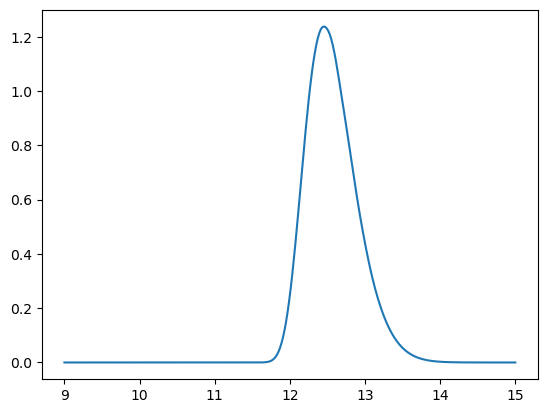

In [9]:
halo = np.load("../etc/halo_mass_PDF_full.npy")
plt.plot(halo[:,0], halo[:,1])

In [174]:
def plot_single_realization(tree, nhalo=20, rand=True, i=10):

    mass = tree["mass"]
    time = tree["CosmicTime"]

    if rand==True:
        select = np.random.randint(1,mass.shape[0],nhalo)
    elif rand==False:
        select = np.linspace(i,i+nhalo, nhalo).astype("int")

    colors = cm.viridis(np.linspace(0, 1, nhalo))

    plt.figure(figsize=(6,6))

    for i in range(nhalo):
        plt.plot(time, mass[select[i]], color=colors[i])

    plt.plot(time, mass[0], color="red")
    plt.xlabel("Gyr", fontsize=15)
    plt.ylabel("halo mass (M$_{\odot}$)", fontsize=15)
    plt.yscale("log")
    plt.axhline(10**8, ls="--", color="black")
    plt.ylim(1e4,1e14)
    plt.show()

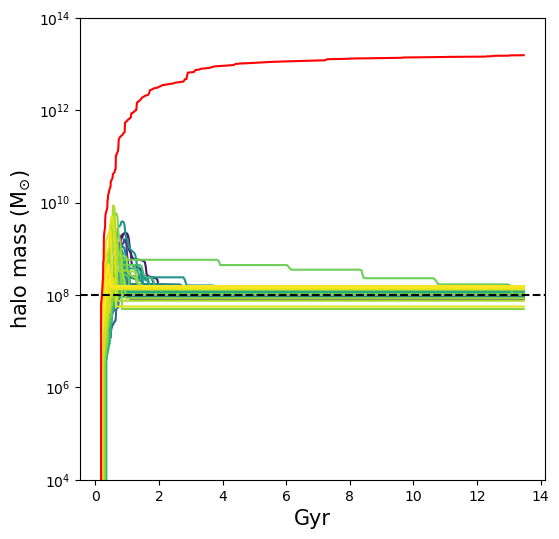

In [194]:
plot_single_realization(np.load("../../data/5_8_0/10^4/tree_13.033_1evo.npz"), 100, rand=False, i=11100)

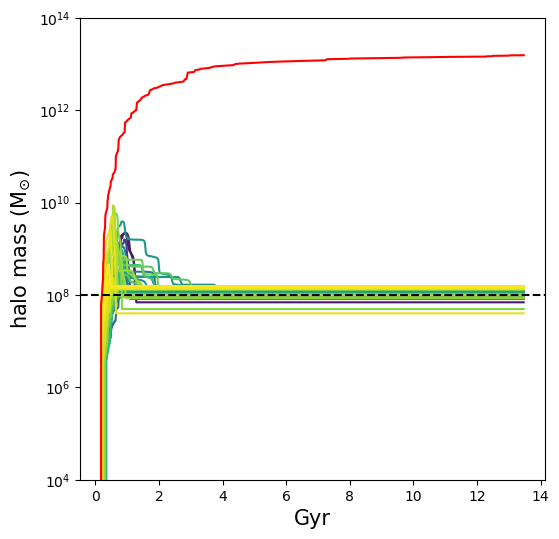

In [195]:
plot_single_realization(np.load("../../data/5_8_0/tree_13.033_1_evo.npz"), 100, rand=False, i=11100)

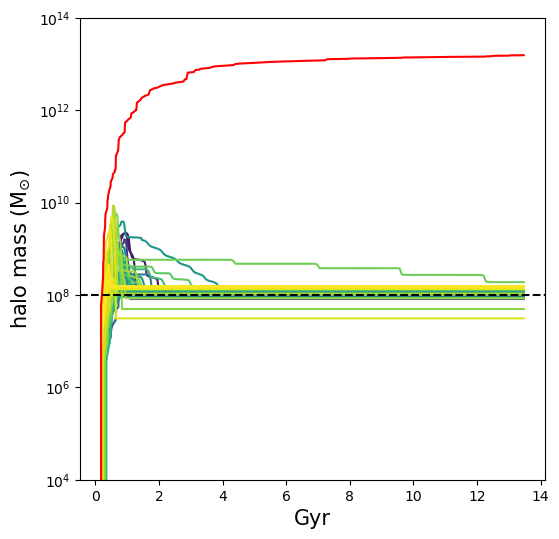

In [196]:
plot_single_realization(np.load("../../data/5_8_0/withering/tree_13.033_1evo.npz"), 100, rand=False, i=11100)

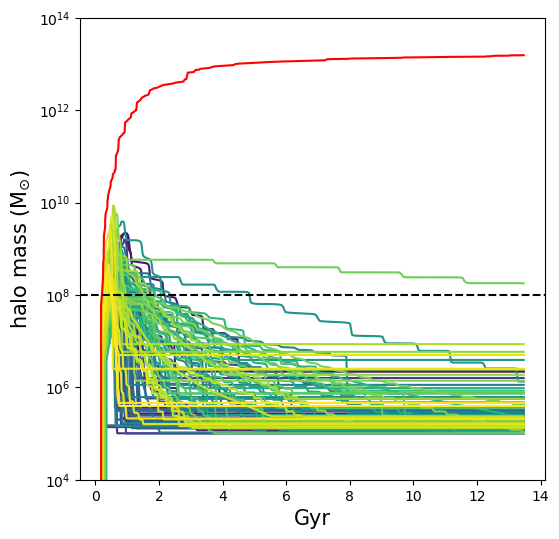

In [186]:
plot_single_realization(np.load("../../data/5_8_0/arbres/tree_13.033_1evo.npz"), 100, rand=False, i=11100)

In [41]:
# def fix_tree(file):
#     tree = np.load(file)
#     mass = tree["mass"]
#     mask = ~np.isnan(mass)
#     new_mass = np.where(mask, mass, -99)

#     np.savez(file, 
#     redshift = tree["redshift"],
#     CosmicTime = tree["CosmicTime"],
#     mass = new_mass,
#     order = tree["order"],
#     ParentID =  tree["ParentID"],
#     VirialRadius =  tree["VirialRadius"],
#     concentration =  tree["concentration"],
#     coordinates =  tree["coordinates"],
#     )

# import os
# files = []    
# for filename in os.listdir("../../data/1000_8_0/"):
#     if filename.startswith('tree') and not filename.endswith('evo.npz'): 
#         files.append(os.path.join("../../data/1000_8_0/", filename))


# for i in files:
#     fix_tree(i)